In [1]:
# This is the week 3 task for the Buckeye AutoDrive team
# This week, you will be learning the data representation from the various sensors on the car
# Your task is to read through the sample codes/comments I provided and finish the tasks specified in the comments
# After you finish the tasks, please zip the finished code along with the generated visualizations and post it on Teams, thanks!
# Good luck! Reach out to me on Teams if you have any questions - Daniel Feng
# Note: To run this code, you need to have Jupyter Notebook installed on your computer

import os
import numpy as np
import plotly.graph_objects as go
import cv2
from matplotlib import pyplot as plt
import json

# Load the data from the file
image_dir = "dataset_Mcity_1_Jun_8_23_KITTI_no_labels/image_2"
lidar_dir = "dataset_Mcity_1_Jun_8_23_KITTI_no_labels/velodyne"
calib_path = "dataset_Mcity_1_Jun_8_23_KITTI_no_labels/calib.json"

# code to load the calibration information from the file
# calibration information is used to project the 3D point cloud to the camera image
def read_calib_file(filepath):
    """
    Read the calibration file and parse the data
    """
    with open(filepath) as f:
        calib = json.load(f)
    return calib

def visualize_pointcloud(pointcloud, color= None):
    """
    Visualize the point cloud
    """
    fig = go.Figure(layout=dict(scene=dict(aspectmode="data")))
    if color is not None:
        # Set the colormap to viridis
        fig.add_trace(go.Scatter3d(x=pointcloud[:, 0], y=pointcloud[:, 1], z=pointcloud[:, 2], mode='markers', marker=dict(size=1, color=color, colorscale='Plasma', opacity=0.8)))
    else:
        fig.add_trace(go.Scatter3d(x=pointcloud[:, 0], y=pointcloud[:, 1], z=pointcloud[:, 2], mode='markers', marker=dict(size=1)))
    return fig


In [2]:

# List the image and lidar files, sort them by name. This will usually align corresponding images and lidar scans,
# as the scans that are taken at the same time will usually share the same file name
image_paths = sorted([os.path.join(image_dir, x) for x in os.listdir(image_dir)])
lidar_paths = sorted([os.path.join(lidar_dir, x) for x in os.listdir(lidar_dir)])

# Let's visualize the first image and the first lidar scan!
# Load the image
image = cv2.imread(image_paths[0])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Load the cepton lidar scan, it's in the form of a binary file,
# storing numpy array with shape (N, 4), where N is the number of points
lidar = np.fromfile(lidar_paths[0], dtype=np.float32).reshape(-1, 4)

# visualize the point cloud
fig = visualize_pointcloud(lidar[:, :3])
fig.show()

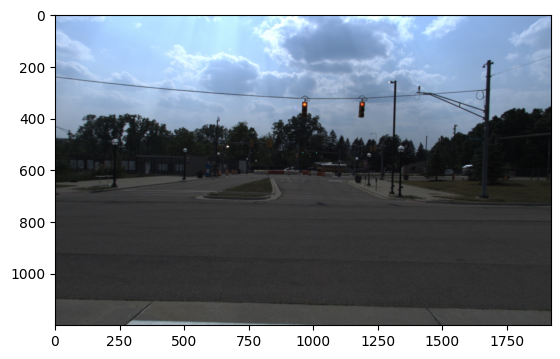

In [3]:
# Visualize the image
plt.imshow(image)

In [4]:
# Now, let's play around with the image data!
# Check the dimensions of the image first!
print("Image shape:", image.shape)

Image shape: (1200, 1920, 3)


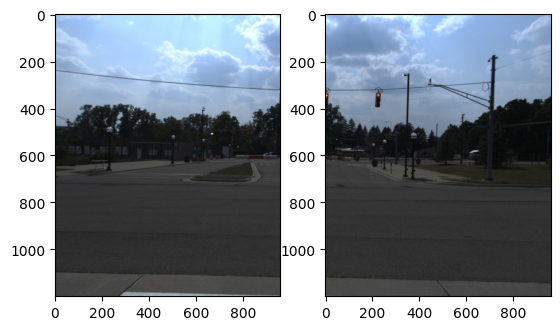

In [5]:
# As you can see, the image is a 3D numpy array, with the first dimension being the height of the image,
# the second dimension being the width of the image, and the third dimension being the color channels (RGB)
# For more information, check this blog: https://developer.ibm.com/articles/learn-the-basics-of-computer-vision-and-object-detection/
# Let's verify this representation!

image_height, image_width, image_channels = image.shape

# Now, let's crop the image width by half:
fig, ax = plt.subplots(1, 2)
image_horizontal_crop = image[:, :image_width // 2, :] # here, we reduce the second dimension of the image data by half
ax[0].imshow(image_horizontal_crop)
image_horizontal_crop2 = image[:, image_width // 2:, :] # take the second half of the image
ax[1].imshow(image_horizontal_crop2)
plt.show()

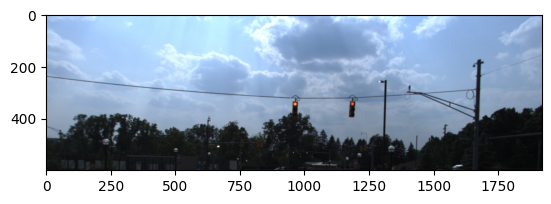

In [7]:
# TODO: Task 1: Let's crop the image height by half and visualize it!
# Write your code here
# Crop the image height by half
image_vertical_crop = image[:image_height // 2, :, :]  # here, we reduce the first dimension of the image data by half

# Visualize the cropped image
plt.imshow(image_vertical_crop)
plt.show()

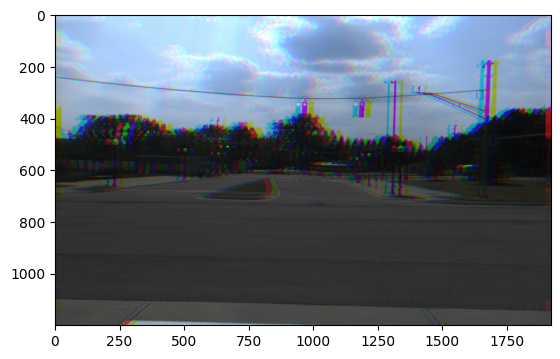

In [8]:
# With the first two dimensions of the image verified, let's check the color channels!
# We first separate the image into red, green, and blue channels
red_channel = image[:, :, 0]
green_channel = image[:, :, 1]
blue_channel = image[:, :, 2]

# Let's offset the red channel by 25 to the left, blue channel by 25 to the right, and visualize the result!
plt.clf()
red_channel_offset = np.roll(red_channel, -25, axis=1) # roll the red channel to the left by 25 pixels
blue_channel_offset = np.roll(blue_channel, 25, axis=1)
image_offset = np.stack([red_channel_offset, green_channel, blue_channel_offset], axis=-1) # stack the channels back together!
plt.imshow(image_offset)

<Figure size 640x480 with 0 Axes>

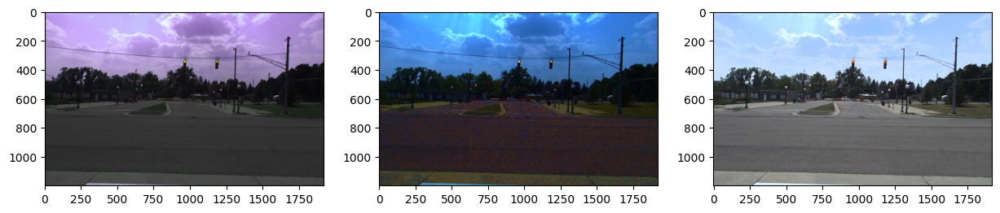

In [9]:
# Pretty cool, right? Now let's introduce the concept of color space!
# The RGB color space is the most common color space, but there are many others!
# One of the most common color spaces we use in computer vision is the HSV color space
# The HSV color space represents colors as Hue, Saturation, and Value
# Let's convert the image to the HSV color space and visualize the channels!

image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
hue_channel = image_hsv[:, :, 0]
saturation_channel = image_hsv[:, :, 1]
value_channel = image_hsv[:, :, 2]

plt.clf()
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
# In the first subplot, we offset all pixel hue by 25 to the right and see what happens!
hue_channel_offset = (hue_channel + 25) % 180 # we need to make sure the hue channel is within the range of 0 to 180
image_hsv_offset = np.stack([hue_channel_offset, saturation_channel, value_channel], axis=-1)
image_rgb_offset = cv2.cvtColor(image_hsv_offset, cv2.COLOR_HSV2RGB) # we always convert the image back to RGB before visualizing it
ax[0].imshow(image_rgb_offset)

# In the second subplot, we increase all pixel saturation by 100 to the left and see what happens!
saturation_channel_offset = np.clip(saturation_channel + 100, 0, 255) # we need to make sure the saturation channel is within the range of 0 to 255
image_hsv_offset = np.stack([hue_channel, saturation_channel_offset, value_channel], axis=-1)
image_rgb_offset = cv2.cvtColor(image_hsv_offset, cv2.COLOR_HSV2RGB)
ax[1].imshow(image_rgb_offset)

# In the third subplot, we increase all pixel values by 2 times and see what happens!
value_channel_offset = np.clip(value_channel.astype(np.int16) * 2, 0, 255).astype(np.uint8) # we need to make sure the value channel is within the range of 0 to 255
image_hsv_offset = np.stack([hue_channel, saturation_channel, value_channel_offset], axis=-1)
image_rgb_offset = cv2.cvtColor(image_hsv_offset, cv2.COLOR_HSV2RGB)
ax[2].imshow(image_rgb_offset)

plt.show()

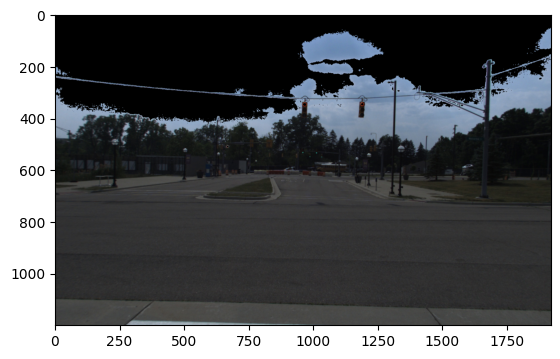

In [10]:
# TODO Task 2: Let's try remove all the bright pixels in the image and visualize it! (remove the sky pixels)
# Hint: Which channel in what color space can help you identify brighter pixels?
# Write your code here
# Convert the image to HSV color space
image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

# Identify bright pixels in the value channel
bright_pixels_mask = image_hsv[:, :, 2] > 200  # You can adjust the threshold value as needed

# Set the bright pixels to black
image_hsv[bright_pixels_mask] = [0, 0, 0]

# Convert back to RGB color space
image_no_bright_pixels = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2RGB)

# Visualize the result
plt.imshow(image_no_bright_pixels)
plt.show()

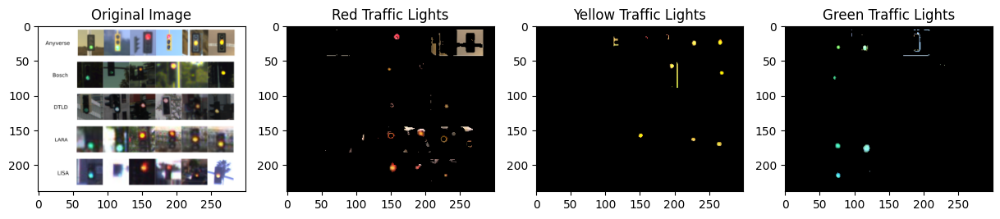

In [11]:
# With all that being said, let's use all the knowledge we learned to do something we can use in the real world!
# Let's try to detect the traffic lights in the image!

tl_image = cv2.imread("dataset_Mcity_1_Jun_8_23_KITTI_no_labels/image.png")

def traffic_light_detection(img, thresholds):
    """
    Detect all active traffic lights from the image.

    Args:
        img (MatLike): cv2 image that contains the traffic light.
        show_layers (bool): show the intermediate color filtering layers, for debugging purposes.

    Returns:
        [red_light, yellow_light, green_light],
        where each (color)_light denotes a list of lights in corresponding
        color in format [x, y, radius].

    """

    # convert target img to hsv color space
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # apply bilateral filter to smooth out some textures
    hsv = cv2.bilateralFilter(hsv, 9,75,75 )
    
    # separate red green yellow color channels and filter out target color
    lower_red1, upper_red1, lower_red2, upper_red2, lower_green, upper_green, lower_yellow, upper_yellow = thresholds
    maskr1 = cv2.inRange(hsv, lower_red1, upper_red1)
    maskr2 = cv2.inRange(hsv, lower_red2, upper_red2)
    maskg = cv2.inRange(hsv, lower_green, upper_green)
    masky = cv2.inRange(hsv, lower_yellow, upper_yellow)
    maskr = cv2.add(maskr1, maskr2)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    red_bulbs = img.copy()
    red_bulbs[maskr == 0] = 0
    green_bulbs = img.copy()
    green_bulbs[maskg == 0] = 0
    yellow_bulbs = img.copy()
    yellow_bulbs[masky == 0] = 0
    return red_bulbs, yellow_bulbs, green_bulbs


lower_red1 = np.array([0,30,100])
upper_red1 = np.array([18,255,255])
lower_red2 = np.array([170,30,200])
upper_red2 = np.array([180,255,255])
lower_green = np.array([50,60,150])
upper_green = np.array([100,255,255])
lower_yellow = np.array([20,115,150])
upper_yellow = np.array([35,255,255])
thresholds = [lower_red1, upper_red1, lower_red2, upper_red2, lower_green, upper_green, lower_yellow, upper_yellow]
results = traffic_light_detection(tl_image, thresholds)

# Let's visualize the results!
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
ax[0].imshow(cv2.cvtColor(tl_image, cv2.COLOR_BGR2RGB))
ax[0].set_title("Original Image")
ax[1].imshow(results[0])
ax[1].set_title("Red Traffic Lights")
ax[2].imshow(results[1])
ax[2].set_title("Yellow Traffic Lights")
ax[3].imshow(results[2])
ax[3].set_title("Green Traffic Lights")
plt.show()

In [12]:
# TODO Task 3: Can you explain how the traffic light detection algorithm works by looking at the code?
# The traffic light detection algorithm works as follows:
# 1. Convert the input image to the HSV color space. This color space is useful for color-based segmentation.
# 2. Apply a bilateral filter to the HSV image to smooth out textures while preserving edges.
# 3. Define color thresholds for red, green, and yellow traffic lights in the HSV color space.
# 4. Create masks for each color by thresholding the HSV image using the defined color ranges.
# 5. Combine the masks for red traffic lights (since red can appear in two different ranges in the HSV space).
# 6. Use the masks to extract the corresponding colored regions from the original image.
# 7. Return the extracted regions for red, yellow, and green traffic lights.

In [13]:
# Now, let's play around with the lidar data!
# Check the dimensions of the lidar data first!
print("Lidar shape:", lidar.shape)

Lidar shape: (28679, 4)


In [14]:
# As you can see, our lidar data is a 2D numpy array, with the first dimension being the number of points,
# and the second dimension being the number of features for each point
# In this case, we have 4 features for each point: x, y, z, and reflectance (how much light is reflected back to the sensor)
# Let's verify this representation!

# visualize the point cloud, coloring by the x coordinate value (darker color means smaller x value)
visualize_pointcloud(lidar[:, :3], color=lidar[:, 0]).show()

In [15]:
# visualize the point cloud, coloring by the y coordinate value (darker color means smaller y value)
visualize_pointcloud(lidar[:, :3], color=lidar[:, 1]).show()

In [16]:
# visualize the point cloud, coloring by the z coordinate value (darker color means smaller z value)
visualize_pointcloud(lidar[:, :3], color=lidar[:, 2]).show()
# as you can see, higher points are colored in brighter colors

In [17]:
# TODO Task 4: Let's try to filter out the points that are below the ground plane and visualize it!
# Hint: It's not a good ground removal method, but it's a simple one
# You can remove points that are below a certain height
# Filter out points below the ground plane (e.g., z < 0)
ground_plane_threshold = 0.0
filtered_lidar = lidar[lidar[:, 2] >= ground_plane_threshold]

# Visualize the filtered point cloud
fig = visualize_pointcloud(filtered_lidar[:, :3])
fig.show()